In [191]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb
import plotly.express as px
import plotly.graph_objects as go

#Machine Learning Libraries
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.metrics import mean_absolute_error
from sklearn.pipeline import make_pipeline
from category_encoders import OneHotEncoder

from ipywidgets import Dropdown, FloatSlider, IntSlider, interact

In [4]:
#Loading Data

data = pd.read_csv('listings.csv')

In [5]:
data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,306333,Rental unit in London · ★4.32 · 2 bedrooms · 3...,1573870,Robert,NaN,Hackney,51.52748,-0.08172,Entire home/apt,156,2,20,2017-05-31,0.25,1,4,0,NaN
1,154221,Rental unit in London · 2 bedrooms · 2 beds · ...,211018,Sylvia,NaN,Westminster,51.48970,-0.13911,Entire home/apt,83,2,1,2016-01-12,0.01,1,0,0,NaN
2,306405,Rental unit in Dagenham · ★4.0 · 1 bedroom · 1...,1575800,Mary,NaN,Barking and Dagenham,51.54072,0.15246,Private room,41,4,3,2012-05-27,0.02,1,365,0,NaN
3,157714,Townhouse in Hammersmith · ★4.71 · 1 bedroom ·...,757377,Eilinn,NaN,Hammersmith and Fulham,51.48974,-0.22208,Private room,69,4,175,2023-05-02,1.21,1,67,10,NaN
4,13913,Rental unit in Islington · ★4.80 · 1 bedroom ·...,54730,Alina,NaN,Islington,51.56861,-0.11270,Private room,79,1,41,2022-12-11,0.26,2,353,15,NaN


In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 81792 entries, 0 to 81791
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              81792 non-null  int64  
 1   name                            81792 non-null  object 
 2   host_id                         81792 non-null  int64  
 3   host_name                       81786 non-null  object 
 4   neighbourhood_group             0 non-null      float64
 5   neighbourhood                   81792 non-null  object 
 6   latitude                        81792 non-null  float64
 7   longitude                       81792 non-null  float64
 8   room_type                       81792 non-null  object 
 9   price                           81792 non-null  int64  
 10  minimum_nights                  81792 non-null  int64  
 11  number_of_reviews               81792 non-null  int64  
 12  last_review                     

In [7]:
data.describe()

,id,host_id,neighbourhood_group,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
count,8.179200e+04,8.179200e+04,0.0,81792.000000,81792.000000,81792.000000,81792.000000,81792.000000,61190.000000,81792.000000,81792.000000,81792.000000,0.0
mean,2.974055e+17,1.491594e+08,NaN,51.509636,-0.128096,187.537204,5.649746,17.941804,0.970620,16.845535,119.303697,5.907448,NaN
std,3.792198e+17,1.611303e+08,NaN,0.048543,0.099242,477.437210,23.002885,42.243186,1.331123,58.645477,133.867681,12.966562,NaN
min,1.391300e+04,2.594000e+03,NaN,51.295937,-0.497800,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000,0.000000,NaN
25%,2.105368e+07,2.102925e+07,NaN,51.483593,-0.189168,61.000000,1.000000,0.000000,0.140000,1.000000,0.000000,0.000000,NaN
50%,4.312050e+07,7.416739e+07,NaN,51.513840,-0.126575,110.000000,2.000000,4.000000,0.500000,1.000000,59.000000,1.000000,NaN
75%,7.293143e+17,2.470452e+08,NaN,51.539468,-0.068390,198.000000,4.000000,16.000000,1.230000,5.000000,245.000000,6.000000,NaN
max,9.092815e+17,5.187276e+08,NaN,51.681502,0.288570,58564.000000,1125.000000,1425.000000,50.500000,543.000000,365.000000,531.000000,NaN


### Exploratory Data Analysis

In [8]:
data.corr()

/tmp/ipykernel_2905/2627137660.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data.corr()


,id,host_id,neighbourhood_group,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
id,1.000000,0.453858,NaN,-0.006059,-0.018121,0.064988,-0.028538,-0.229467,0.389142,0.119142,0.357628,-0.033162,NaN
host_id,0.453858,1.000000,NaN,-0.003875,-0.007290,0.034267,-0.002800,-0.123426,0.250877,0.018209,0.285284,0.040354,NaN
neighbourhood_group,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
latitude,-0.006059,-0.003875,NaN,1.000000,0.089748,0.007312,0.003270,-0.005873,0.001510,0.035772,-0.002608,-0.002722,NaN
longitude,-0.018121,-0.007290,NaN,0.089748,1.000000,-0.042409,0.002320,-0.026963,-0.014186,-0.072274,-0.020920,-0.019201,NaN
price,0.064988,0.034267,NaN,0.007312,-0.042409,1.000000,0.025643,-0.039436,-0.019244,0.249817,0.103701,-0.035842,NaN
minimum_nights,-0.028538,-0.002800,NaN,0.003270,0.002320,0.025643,1.000000,-0.029304,-0.063973,0.018116,0.040713,-0.056696,NaN
number_of_reviews,-0.229467,-0.123426,NaN,-0.005873,-0.026963,-0.039436,-0.029304,1.000000,0.450522,-0.061883,0.024974,0.689645,NaN
reviews_per_month,0.389142,0.250877,NaN,0.001510,-0.014186,-0.019244,-0.063973,0.450522,1.000000,-0.033356,0.206189,0.708633,NaN
calculated_host_listings_count,0.119142,0.018209,NaN,0.035772,-0.072274,0.249817,0.018116,-0.061883,-0.033356,1.000000,0.116996,-0.054765,NaN


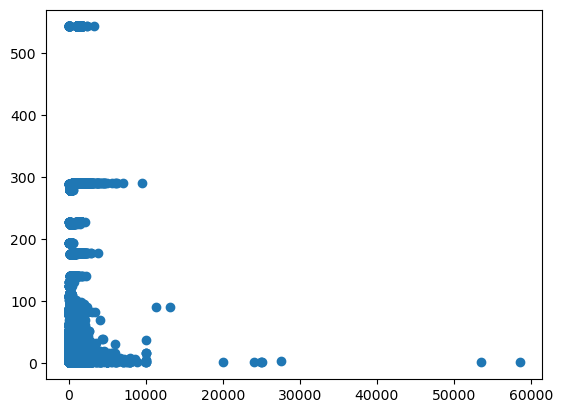

In [9]:
plt.scatter(data['price'], data['calculated_host_listings_count']);

## Split

In [10]:
feature = ['calculated_host_listings_count']
X_train = data[feature]

In [11]:
target = ['price']
y_train = data[target]

### Build Model

In [12]:
y_mean = y_train.mean()
y_mean

price    187.537204
dtype: float64

In [13]:
y_pred_baseline = [y_mean] * len(y_train)

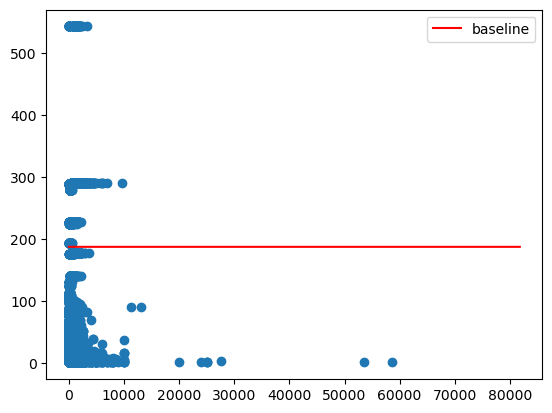

In [14]:
plt.plot(y_pred_baseline, color = 'red', label = 'baseline');
plt.scatter(data['price'], data['calculated_host_listings_count']);
plt.legend();

In [15]:
#Mean Absolute Error

mae = mean_absolute_error(y_train, y_pred_baseline)

print("Mean AirBnB Price:", round(y_mean, 2))
print("Baseline MAE:", round(mae, 2))

Mean AirBnB Price: price    187.54
dtype: float64
Baseline MAE: 144.43


In [16]:
#Model Instantiating

model = LinearRegression()

In [17]:
#Training Model

model.fit(X_train, y_train)

LinearRegression()

In [18]:
y_pred_training =model.predict(X_train)
y_pred_training[:5]

array([[155.31083006],
       [155.31083006],
       [155.31083006],
       [155.31083006],
       [157.3446127 ]])

In [19]:
mae_training = mean_absolute_error(y_train, y_pred_training)

mae_training

130.1265039396082

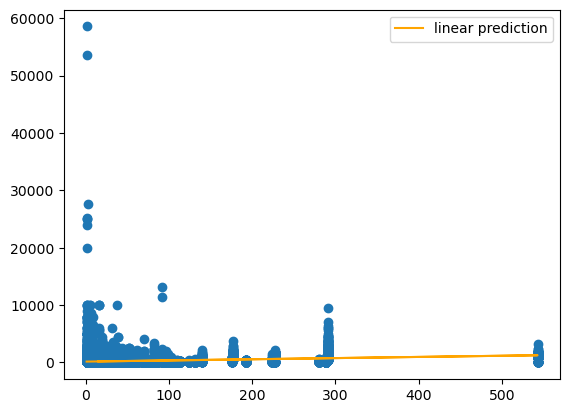

In [20]:
plt.plot(X_train.values, model.predict(X_train), color = 'orange', label = 'linear prediction');
plt.scatter(X_train, y_train);
plt.legend()

## Price Vs Location Predictor

In [21]:
fig = px.scatter_mapbox(
    data,
    lat = 'latitude',
    lon = 'longitude',
    width = 500,
    height = 500,
    color = 'price',
    hover_data = ['price']
)

fig.update_layout(mapbox_style = 'open-street-map')

fig.show()

In [22]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 81792 entries, 0 to 81791
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              81792 non-null  int64  
 1   name                            81792 non-null  object 
 2   host_id                         81792 non-null  int64  
 3   host_name                       81786 non-null  object 
 4   neighbourhood_group             0 non-null      float64
 5   neighbourhood                   81792 non-null  object 
 6   latitude                        81792 non-null  float64
 7   longitude                       81792 non-null  float64
 8   room_type                       81792 non-null  object 
 9   price                           81792 non-null  int64  
 10  minimum_nights                  81792 non-null  int64  
 11  number_of_reviews               81792 non-null  int64  
 12  last_review                     

In [23]:
# Creating a 3D Scatter Plot

fig = px.scatter_3d(
    data,
    x = 'longitude',
    y = 'latitude',
    z = 'price',
    labels = {'longitude':'Longitude', 'latitude':'Latitude', 'price':'Price'},
    width = 600,
    height = 600,
    color = 'price',
)

#Refine  Formatting
fig.update_traces(
    marker = {'size': 4, 'line': {'width': 2, 'color': 'DarkSlateGrey'}},
    selector = {'mode': 'markers'},
)

fig.show()

#### Split

In [24]:
features = ['longitude', 'latitude']
X_train = data[features]

In [25]:
target = 'price'
y_train = data[target]

### Model Building

In [26]:
#Building model

location_model = LinearRegression()

In [27]:
location_model.fit(X_train, y_train)

LinearRegression()

In [28]:
location_pred_training = location_model.predict(X_train)

In [29]:
location_mae_training = mean_absolute_error(y_train, location_pred_training)
location_mae_training

143.69259392088378

### Communicating Results

In [30]:
location_intercept = location_model.intercept_.round(0)
location_coefficients = location_model.coef_.round(0)

print(location_intercept)
print(location_coefficients)

-5518.0
[-209.  110.]


In [31]:
print(
    f"price = {location_intercept} + ({location_coefficients} * longitude) + ({location_coefficients} * latitude)" 
)

price = -5518.0 + ([-209.  110.] * longitude) + ([-209.  110.] * latitude)


In [32]:
#Results 3D Scatter Plot

fig = px.scatter_3d(
    data,
    x = 'longitude',
    y = 'latitude',
    z = 'price',
    labels = {'longitude':'Longitude', 'latitude':'Latitude', 'price':'Price'},
    width = 600,
    height = 600,
    color = 'price',
)

#Create x and y coordinates for model representation
x_plane = np.linspace(data['longitude'].min(), data['longitude'].max(), 10)
y_plane = np.linspace(data['latitude'].min(), data['latitude'].max(), 10)
xx, yy = np.meshgrid(x_plane, y_plane)

#Use model to predict z Coordinates
z_plane = location_model.predict(pd.DataFrame({'longitude': x_plane, 'latitude': y_plane}))
zz = np.tile(z_plane, (10, 1))

#Add a Plane to the figure
fig.add_trace(go.Surface(x = xx, y = yy, z = zz))

#Refine  Formatting
fig.update_traces(
    marker = {'size': 4, 'line': {'width': 2, 'color': 'DarkSlateGrey'}},
    selector = {'mode': 'markers'},
)

fig.show()


## Price Vs Neighborhood Predictor

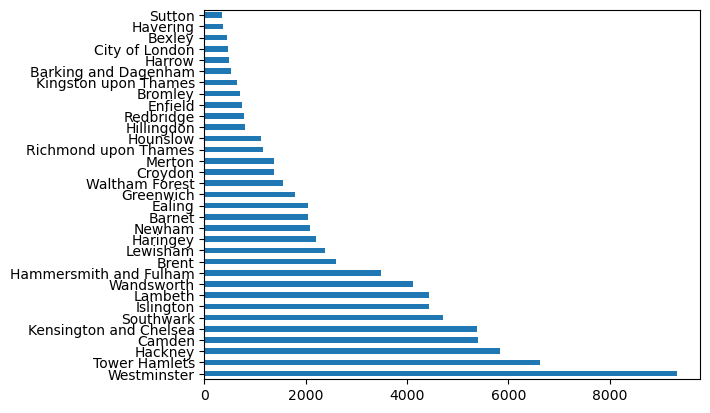

In [51]:
data['
     '].value_counts().plot(kind = 'barh');

In [52]:
mae

144.42554539466192

In [64]:
y_mean

price    187.537204
dtype: float64

#### SPLIT 

In [54]:
features = data['neighbourhood']
target = data['price']

In [59]:
X_train = features
y_train = target

In [72]:
#Instantiate OneHotEncoder

ohe = OneHotEncoder(use_cat_names = True)

#Fit
ohe.fit(X_train)
XT_train = ohe.transform(X_train)

In [74]:
XT_train.head()

,neighbourhood_Hackney,neighbourhood_Westminster,neighbourhood_Barking and Dagenham,neighbourhood_Hammersmith and Fulham,neighbourhood_Islington,neighbourhood_Kensington and Chelsea,neighbourhood_Southwark,neighbourhood_Lambeth,neighbourhood_Camden,neighbourhood_Wandsworth,...,neighbourhood_Enfield,neighbourhood_City of London,neighbourhood_Ealing,neighbourhood_Bromley,neighbourhood_Havering,neighbourhood_Harrow,neighbourhood_Kingston upon Thames,neighbourhood_Redbridge,neighbourhood_Bexley,neighbourhood_Sutton
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [75]:
#Model Instantiting
neighbourhood_model = make_pipeline(
    OneHotEncoder(use_cat_names = True),
    Ridge()
)

#Fitting
neighbourhood_model.fit(X_train, y_train)

Pipeline(steps=[('onehotencoder',
                 OneHotEncoder(cols=['neighbourhood'], use_cat_names=True)),
                ('ridge', Ridge())])

In [76]:
neighbourhood_pred = neighbourhood_model.predict(X_train)

In [79]:
neighbourhood_mae = mean_absolute_error(y_train, neighbourhood_pred)
neighbourhood_mae

135.41701617312083

## Price Vs Everything Predictor

In [81]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 81792 entries, 0 to 81791
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              81792 non-null  int64  
 1   name                            81792 non-null  object 
 2   host_id                         81792 non-null  int64  
 3   host_name                       81786 non-null  object 
 4   neighbourhood_group             0 non-null      float64
 5   neighbourhood                   81792 non-null  object 
 6   latitude                        81792 non-null  float64
 7   longitude                       81792 non-null  float64
 8   room_type                       81792 non-null  object 
 9   price                           81792 non-null  int64  
 10  minimum_nights                  81792 non-null  int64  
 11  number_of_reviews               81792 non-null  int64  
 12  last_review                     

In [82]:
#Split 

target = 'price'
features = ['calculated_host_listings_count','longitude', 'latitude', 'neighbourhood']

X_train = data[features]
y_train = data[target]

In [86]:
mae

144.42554539466192

In [87]:
y_mean

price    187.537204
dtype: float64

In [88]:
#Instantiate OneHotEncoder

ohe = OneHotEncoder(use_cat_names = True)

#Fit
ohe.fit(X_train)
XT_train = ohe.transform(X_train)

In [90]:
XT_train.head()

,calculated_host_listings_count,longitude,latitude,neighbourhood_Hackney,neighbourhood_Westminster,neighbourhood_Barking and Dagenham,neighbourhood_Hammersmith and Fulham,neighbourhood_Islington,neighbourhood_Kensington and Chelsea,neighbourhood_Southwark,...,neighbourhood_Enfield,neighbourhood_City of London,neighbourhood_Ealing,neighbourhood_Bromley,neighbourhood_Havering,neighbourhood_Harrow,neighbourhood_Kingston upon Thames,neighbourhood_Redbridge,neighbourhood_Bexley,neighbourhood_Sutton
0,1,-0.08172,51.52748,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,-0.13911,51.48970,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0.15246,51.54072,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,-0.22208,51.48974,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,2,-0.11270,51.56861,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [91]:
#Model Instatiate

evr_model = make_pipeline(
    OneHotEncoder(use_cat_names = True),
    Ridge()
)

In [92]:
#Fit Model

evr_model.fit(X_train, y_train)

Pipeline(steps=[('onehotencoder',
                 OneHotEncoder(cols=['neighbourhood'], use_cat_names=True)),
                ('ridge', Ridge())])

In [95]:
#Training
prediction = evr_model.predict(X_train)

In [98]:
#MEA

prediction_mea = mean_absolute_error(y_train, evr_pred_training).round(2)
prediction_mea

124.34

In [145]:
prediction.mean()

187.53720412754262

### Creating a function to Combine all this into an interactive Widget

In [185]:
def make_prediction(calculated_host_listings_count, longitude, latitude, neighbourhood):
    data_points = {
        'calculated_host_listings_count': calculated_host_listings_count,
        'longitude': longitude,
        'latitude': latitude,
        'neighbourhood': neighbourhood
    }
    df = pd.DataFrame(data_points, index = [0])
    prediction = evr_model.predict(df).round(2)[0]
    
    return f"Predicted House Price is: ${prediction}"

In [161]:
make_prediction

<function __main__.make_prediction(calculated_host_listings_count, longitude, latitude, neighbourhood)>

In [158]:
data.sample()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
45004,49725292,Bed and breakfast in Greater London · 1 bedroo...,310650597,Karandeep,NaN,Richmond upon Thames,51.45471,-0.33863,Private room,85,1,0,NaN,NaN,7,0,0,NaN


In [188]:
make_prediction(7, 51.572581, -0.200353, 'Richmond upon Thames')

'Predicted House Price is: $15993.8'

In [201]:
#Interactive Widget to Predict House Prices

interact(
    make_prediction,
    Listing = IntSlider(
        min = X_train['calculated_host_listings_count'].min(),
        max = X_train['calculated_host_listings_count'].max(),
        value = X_train['calculated_host_listings_count'].mean(),
    ),
    Longitude = FloatSlider(
        min = X_train['longitude'].min(),
        max = X_train['longitude'].max(),
        value = X_train['longitude'].mean(),
    ),
    latitude = FloatSlider(
        min = X_train['latitude'].min(),
        max = X_train['latitude'].max(),
        value = X_train['latitude'].mean(),
    ),
    neighbourhood = Dropdown(options = sorted(X_train['neighbourhood'].unique())),
    
);

ValueError: cannot find widget or abbreviation for argument: 'calculated_host_listings_count'

In [193]:
X_train

,calculated_host_listings_count,longitude,latitude,neighbourhood
0,1,-0.081720,51.527480,Hackney
1,1,-0.139110,51.489700,Westminster
2,1,0.152460,51.540720,Barking and Dagenham
3,1,-0.222080,51.489740,Hammersmith and Fulham
4,2,-0.112700,51.568610,Islington
...,...,...,...,...
81787,280,-0.176821,51.531046,Westminster
81788,280,-0.114164,51.499511,Lambeth
81789,1,-0.067643,51.557216,Hackney
81790,2,-0.179570,51.515650,Westminster
